In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from subprocess import check_output
%matplotlib inline
import plotly.offline as py
py.init_notebook_mode(connected=True)

import plotly.graph_objs as go
import plotly.tools as tls
import os
import gc

import re
from nltk.corpus import stopwords
from nltk.stem import PorterStemmer
from bs4 import BeautifulSoup

In [2]:
quora=pd.read_csv('Questions.csv')
print("Total questions:-",quora.shape[0])

Total questions:- 404351


In [4]:
quora.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 404351 entries, 0 to 404350
Data columns (total 6 columns):
id              404351 non-null int64
qid1            404351 non-null int64
qid2            404351 non-null int64
question1       404350 non-null object
question2       404349 non-null object
is_duplicate    404351 non-null int64
dtypes: int64(4), object(2)
memory usage: 18.5+ MB


In [5]:
quora.columns

Index(['id', 'qid1', 'qid2', 'question1', 'question2', 'is_duplicate'], dtype='object')

In [6]:
quora

,id,qid1,qid2,question1,question2,is_duplicate
0,0,1,2,What is the step by step guide to invest in sh...,What is the step by step guide to invest in sh...,0
1,1,3,4,What is the story of Kohinoor (Koh-i-Noor) Dia...,What would happen if the Indian government sto...,0
2,2,5,6,How can I increase the speed of my internet co...,How can Internet speed be increased by hacking...,0
3,3,7,8,Why am I mentally very lonely? How can I solve...,Find the remainder when [math]23^{24}[/math] i...,0
4,4,9,10,"Which one dissolve in water quikly sugar, salt...",Which fish would survive in salt water?,0
...,...,...,...,...,...,...
404346,404346,789792,789793,How many keywords are there in the Racket prog...,How many keywords are there in PERL Programmin...,0
404347,404347,789794,789795,Do you believe there is life after death?,Is it true that there is life after death?,1
404348,404348,789796,789797,What is one coin?,What's this coin?,0
404349,404349,789798,789799,What is the approx annual cost of living while...,I am having little hairfall problem but I want...,0


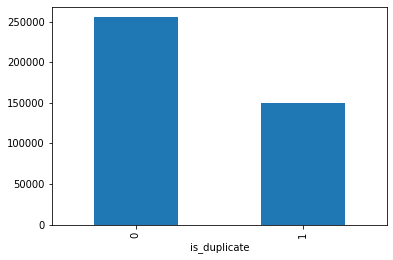

In [6]:
quora.groupby('is_duplicate')['id'].count().plot.bar()

In [7]:
print("Percentage of question pair similar:-\n",(quora[quora['is_duplicate']==1].count()/quora['id'].count())*100)

Percentage of question pair similar:-
 id              36.92485
qid1            36.92485
qid2            36.92485
question1       36.92485
question2       36.92485
is_duplicate    36.92485
dtype: float64


In [8]:
print("Percentage of question pair not similar:-\n",(quora[quora['is_duplicate']==0].count()/quora['id'].count())*100)

Percentage of question pair not similar:-
 id              63.075150
qid1            63.075150
qid2            63.075150
question1       63.074903
question2       63.074655
is_duplicate    63.075150
dtype: float64


In [9]:
total_qids=pd.Series(quora['qid1'].tolist()+quora['qid2'].tolist())
unique_ques=np.unique(total_qids)
repeated_ques=np.sum(total_qids.value_counts() >1)

print("unique questions:-",len(unique_ques))
print("repeated questions:-",repeated_ques)
print("question repeated most no. of times:-",np.max(total_qids.value_counts()))

unique questions:- 789801
repeated questions:- 13698
question repeated most no. of times:- 50


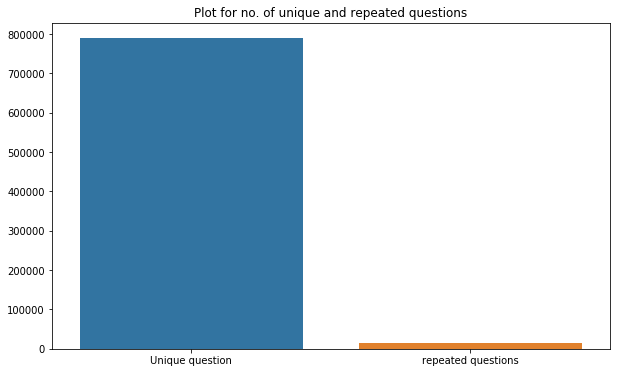

In [10]:
plt.figure(figsize=(10,6))
plt.title("Plot for no. of unique and repeated questions")
x=['Unique question','repeated questions']
y=[len(unique_ques),repeated_ques]
sns.barplot(x,y)
plt.show()

In [11]:
print(total_qids.value_counts())

65333     50
7863      47
147324    41
2628      28
196396    26
          ..
401296     1
452495     1
454542     1
456589     1
2049       1
Length: 789801, dtype: int64


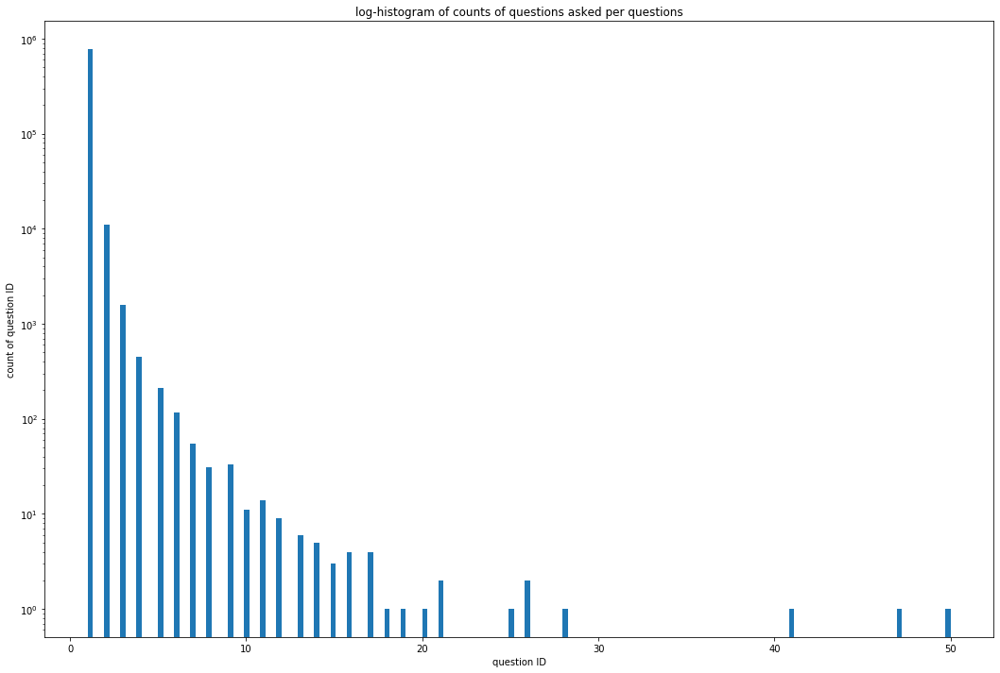

In [12]:
plt.figure(figsize=(18,12))
plt.hist(total_qids.value_counts(),bins=160)
plt.yscale('log',nonposy='clip')
plt.title("log-histogram of counts of questions asked per questions")
plt.xlabel('question ID')
plt.ylabel('count of question ID')
plt.show()

In [7]:
quora=quora.fillna('')
quora.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 404351 entries, 0 to 404350
Data columns (total 6 columns):
id              404351 non-null int64
qid1            404351 non-null int64
qid2            404351 non-null int64
question1       404351 non-null object
question2       404351 non-null object
is_duplicate    404351 non-null int64
dtypes: int64(4), object(2)
memory usage: 18.5+ MB


In [8]:
quora['freq_qid1']=quora.groupby('qid1')['qid1'].transform('count')
quora['freq_qid2']=quora.groupby('qid2')['qid2'].transform('count')
quora['q1len']=quora['question1'].str.len()
quora['q2len']=quora['question2'].str.len()
quora['q1_n_words']=quora['question1'].apply(lambda row: len(row.split()))
quora['q2_n_words']=quora['question2'].apply(lambda row: len(row.split()))
quora['word_Common']=((quora['q1_n_words']&quora['q2_n_words']))
quora['word_total']=quora['q1_n_words']+quora['q2_n_words']
quora['word_share']=quora['word_Common']/quora['word_total']
quora['freq_qid1+freq_qid2']=quora['freq_qid1']+quora['freq_qid2']
quora['freq_qid1-freq_qid2']=quora['freq_qid1']-quora['freq_qid2']
quora

,id,qid1,qid2,question1,question2,is_duplicate,freq_qid1,freq_qid2,q1len,q2len,q1_n_words,q2_n_words,word_Common,word_total,word_share,freq_qid1+freq_qid2,freq_qid1-freq_qid2
0,0,1,2,What is the step by step guide to invest in sh...,What is the step by step guide to invest in sh...,0,1,1,66,57,14,12,12,26,0.461538,2,0
1,1,3,4,What is the story of Kohinoor (Koh-i-Noor) Dia...,What would happen if the Indian government sto...,0,1,1,51,88,8,13,8,21,0.380952,2,0
2,2,5,6,How can I increase the speed of my internet co...,How can Internet speed be increased by hacking...,0,1,1,73,59,14,10,10,24,0.416667,2,0
3,3,7,8,Why am I mentally very lonely? How can I solve...,Find the remainder when [math]23^{24}[/math] i...,0,1,1,50,65,11,9,9,20,0.450000,2,0
4,4,9,10,"Which one dissolve in water quikly sugar, salt...",Which fish would survive in salt water?,0,1,1,76,39,13,7,5,20,0.250000,2,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
404346,404346,789792,789793,How many keywords are there in the Racket prog...,How many keywords are there in PERL Programmin...,0,1,1,85,79,14,13,12,27,0.444444,2,0
404347,404347,789794,789795,Do you believe there is life after death?,Is it true that there is life after death?,1,1,1,41,42,8,9,8,17,0.470588,2,0
404348,404348,789796,789797,What is one coin?,What's this coin?,0,1,1,17,17,4,3,0,7,0.000000,2,0
404349,404349,789798,789799,What is the approx annual cost of living while...,I am having little hairfall problem but I want...,0,1,1,94,127,17,25,17,42,0.404762,2,0


In [15]:
print("minimum length of any question:-",min(quora['q1len'].min(),quora['q2len'].min()))
print("maximum length of any question:-",max(quora['q1len'].max(),quora['q2len'].max()))
print("no. of questions with minimum length:-",len(quora[quora['q1len']==0])+len(quora[quora['q2len']==0]))
print("no. of questions with maximum length:-",len(quora[quora['q1len']==1169])+len(quora[quora['q2len']==1169]))

minimum length of any question:- 0
maximum length of any question:- 1169
no. of questions with minimum length:- 3
no. of questions with maximum length:- 3


In [16]:
print(quora.groupby('qid1')['qid1'].value_counts())

qid1    qid1  
1       1         1
3       3         1
5       5         1
7       7         1
9       9         1
                 ..
789792  789792    1
789794  789794    1
789796  789796    1
789798  789798    1
789800  789800    1
Name: qid1, Length: 399334, dtype: int64


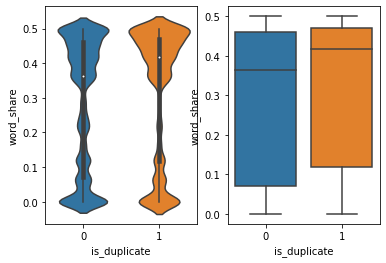

In [17]:
plt.subplot(1,2,1)
sns.violinplot(x='is_duplicate',y='word_share',data=quora,size=15)
plt.subplot(1,2,2)
sns.boxplot(x='is_duplicate',y='word_share',data=quora)
plt.show()

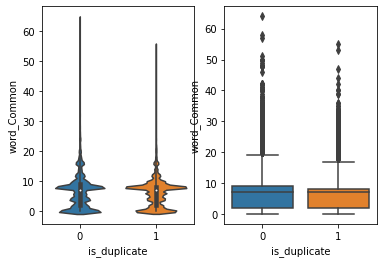

In [18]:
plt.subplot(1,2,1)
sns.violinplot(x='is_duplicate',y='word_Common',data=quora,size=15)
plt.subplot(1,2,2)
sns.boxplot(x='is_duplicate',y='word_Common',data=quora)
plt.show()

In [9]:
quora['question1']=quora['question1'].apply(lambda row: row.lower())
quora['question2']=quora['question2'].apply(lambda row: row.lower())
print(quora)

            id    qid1    qid2  \
0            0       1       2   
1            1       3       4   
2            2       5       6   
3            3       7       8   
4            4       9      10   
...        ...     ...     ...   
404346  404346  789792  789793   
404347  404347  789794  789795   
404348  404348  789796  789797   
404349  404349  789798  789799   
404350  404350  789800  789801   

                                                question1  \
0       what is the step by step guide to invest in sh...   
1       what is the story of kohinoor (koh-i-noor) dia...   
2       how can i increase the speed of my internet co...   
3       why am i mentally very lonely? how can i solve...   
4       which one dissolve in water quikly sugar, salt...   
...                                                   ...   
404346  how many keywords are there in the racket prog...   
404347          do you believe there is life after death?   
404348                                  wh

In [10]:
import string
def remove_punctuation(text): 
    translator = str.maketrans('', '', string.punctuation) 
    return text.translate(translator) 

quora['question1']=quora['question1'].apply(lambda row: remove_punctuation(row))
quora['question2']=quora['question2'].apply(lambda row: remove_punctuation(row))
print(quora)

            id    qid1    qid2  \
0            0       1       2   
1            1       3       4   
2            2       5       6   
3            3       7       8   
4            4       9      10   
...        ...     ...     ...   
404346  404346  789792  789793   
404347  404347  789794  789795   
404348  404348  789796  789797   
404349  404349  789798  789799   
404350  404350  789800  789801   

                                                question1  \
0       what is the step by step guide to invest in sh...   
1          what is the story of kohinoor kohinoor diamond   
2       how can i increase the speed of my internet co...   
3        why am i mentally very lonely how can i solve it   
4       which one dissolve in water quikly sugar salt ...   
...                                                   ...   
404346  how many keywords are there in the racket prog...   
404347           do you believe there is life after death   
404348                                   w

In [11]:
!pip install inflect
import inflect
ishneet=inflect.engine()

def convert_number(text): 
    # split string into list of words 
    temp_str = text.split() 
    # initialise empty list 
    new_string = [] 
  
    for word in temp_str: 
        # if word is a digit, convert the digit 
        # to numbers and append into the new_string list 
        if word.isdigit(): 
            temp = ishneet.number_to_words(word) 
            new_string.append(temp) 
  
        # append the word as it is 
        else: 
            new_string.append(word) 
  
    # join the words of new_string to form a string 
    temp_str = ' '.join(new_string) 
    return temp_str 

quora['question1']=quora['question1'].apply(lambda row: convert_number(row))
quora['question2']=quora['question2'].apply(lambda row: convert_number(row))
print(quora)

            id    qid1    qid2  \
0            0       1       2   
1            1       3       4   
2            2       5       6   
3            3       7       8   
4            4       9      10   
...        ...     ...     ...   
404346  404346  789792  789793   
404347  404347  789794  789795   
404348  404348  789796  789797   
404349  404349  789798  789799   
404350  404350  789800  789801   

                                                question1  \
0       what is the step by step guide to invest in sh...   
1          what is the story of kohinoor kohinoor diamond   
2       how can i increase the speed of my internet co...   
3        why am i mentally very lonely how can i solve it   
4       which one dissolve in water quikly sugar salt ...   
...                                                   ...   
404346  how many keywords are there in the racket prog...   
404347           do you believe there is life after death   
404348                                   w

In [12]:
def remove_whitespace(text): 
    return  " ".join(text.split()) 

quora['question1']=quora['question1'].apply(lambda row: remove_whitespace(row))
quora['question2']=quora['question2'].apply(lambda row: remove_whitespace(row))
print(quora)

            id    qid1    qid2  \
0            0       1       2   
1            1       3       4   
2            2       5       6   
3            3       7       8   
4            4       9      10   
...        ...     ...     ...   
404346  404346  789792  789793   
404347  404347  789794  789795   
404348  404348  789796  789797   
404349  404349  789798  789799   
404350  404350  789800  789801   

                                                question1  \
0       what is the step by step guide to invest in sh...   
1          what is the story of kohinoor kohinoor diamond   
2       how can i increase the speed of my internet co...   
3        why am i mentally very lonely how can i solve it   
4       which one dissolve in water quikly sugar salt ...   
...                                                   ...   
404346  how many keywords are there in the racket prog...   
404347           do you believe there is life after death   
404348                                   w

In [13]:
# do not worry about error as stopwords were previouly removed
from nltk.corpus import stopwords 
from nltk.tokenize import word_tokenize

def remove_stopwords(sentence): 
    stop_words = set(stopwords.words("english")) 
    word_tokens = word_tokenize(sentence) 
    filtered_text = [word for word in word_tokens if word not in stop_words] 
    return filtered_text 

quora['question1']=quora['question1'].apply(lambda row: remove_stopwords(row))
quora['question2']=quora['question2'].apply(lambda row: remove_stopwords(row))
print(quora)

            id    qid1    qid2  \
0            0       1       2   
1            1       3       4   
2            2       5       6   
3            3       7       8   
4            4       9      10   
...        ...     ...     ...   
404346  404346  789792  789793   
404347  404347  789794  789795   
404348  404348  789796  789797   
404349  404349  789798  789799   
404350  404350  789800  789801   

                                                question1  \
0       [step, step, guide, invest, share, market, india]   
1                    [story, kohinoor, kohinoor, diamond]   
2       [increase, speed, internet, connection, using,...   
3                               [mentally, lonely, solve]   
4       [one, dissolve, water, quikly, sugar, salt, me...   
...                                                   ...   
404346  [many, keywords, racket, programming, language...   
404347                             [believe, life, death]   
404348                                    

In [14]:
from nltk.stem.porter import PorterStemmer
stemmer = PorterStemmer() 
  
# stem words in the list of tokenised words 
def stem_words(text): 
    stems = [stemmer.stem(word) for word in text] 
    return stems 

quora['question1']=quora['question1'].apply(lambda row: stem_words(row))
quora['question2']=quora['question2'].apply(lambda row: stem_words(row))
print(quora)

            id    qid1    qid2  \
0            0       1       2   
1            1       3       4   
2            2       5       6   
3            3       7       8   
4            4       9      10   
...        ...     ...     ...   
404346  404346  789792  789793   
404347  404347  789794  789795   
404348  404348  789796  789797   
404349  404349  789798  789799   
404350  404350  789800  789801   

                                                question1  \
0        [step, step, guid, invest, share, market, india]   
1                    [stori, kohinoor, kohinoor, diamond]   
2           [increas, speed, internet, connect, use, vpn]   
3                                    [mental, lone, solv]   
4       [one, dissolv, water, quikli, sugar, salt, met...   
...                                                   ...   
404346  [mani, keyword, racket, program, languag, late...   
404347                              [believ, life, death]   
404348                                    

In [15]:
import nltk
nltk.download('wordnet')
from nltk.corpus import wordnet
from nltk.stem import WordNetLemmatizer 
lemmatizer = WordNetLemmatizer() 
# lemmatize string 
def lemmatize_word(text): 
    # provide context i.e. part-of-speech 
    lemmas = [lemmatizer.lemmatize(word, pos ='v') for word in text] 
    return lemmas 

quora['question1']=quora['question1'].apply(lambda row: lemmatize_word(row))
quora['question2']=quora['question2'].apply(lambda row: lemmatize_word(row))
print(quora)

[nltk_data] Error loading wordnet: <urlopen error [Errno 11001]
[nltk_data]     getaddrinfo failed>


            id    qid1    qid2  \
0            0       1       2   
1            1       3       4   
2            2       5       6   
3            3       7       8   
4            4       9      10   
...        ...     ...     ...   
404346  404346  789792  789793   
404347  404347  789794  789795   
404348  404348  789796  789797   
404349  404349  789798  789799   
404350  404350  789800  789801   

                                                question1  \
0        [step, step, guid, invest, share, market, india]   
1                    [stori, kohinoor, kohinoor, diamond]   
2           [increas, speed, internet, connect, use, vpn]   
3                                    [mental, lone, solv]   
4       [one, dissolv, water, quikli, sugar, salt, met...   
...                                                   ...   
404346  [mani, keyword, racket, program, languag, late...   
404347                              [believ, life, death]   
404348                                    

In [16]:
cwc_min=[]
cwc_max=[]
for i in np.arange(0,404351):
    cwc_min.append(quora.loc[i]['word_Common']/min(quora.loc[i]['q1_n_words'],quora.loc[i]['q2_n_words']))
    cwc_max.append(quora.loc[i]['word_Common']/max(quora.loc[i]['q1_n_words'],quora.loc[i]['q2_n_words']))

C:\Users\aditya raj\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: RuntimeWarning:

invalid value encountered in longlong_scalars



In [17]:
quora['cwc_min']=cwc_min
quora['cwc_max']=cwc_max
print(quora)

            id    qid1    qid2  \
0            0       1       2   
1            1       3       4   
2            2       5       6   
3            3       7       8   
4            4       9      10   
...        ...     ...     ...   
404346  404346  789792  789793   
404347  404347  789794  789795   
404348  404348  789796  789797   
404349  404349  789798  789799   
404350  404350  789800  789801   

                                                question1  \
0        [step, step, guid, invest, share, market, india]   
1                    [stori, kohinoor, kohinoor, diamond]   
2           [increas, speed, internet, connect, use, vpn]   
3                                    [mental, lone, solv]   
4       [one, dissolv, water, quikli, sugar, salt, met...   
...                                                   ...   
404346  [mani, keyword, racket, program, languag, late...   
404347                              [believ, life, death]   
404348                                    

In [18]:
quora1=pd.read_csv('Questions.csv')
print(quora1)

            id    qid1    qid2  \
0            0       1       2   
1            1       3       4   
2            2       5       6   
3            3       7       8   
4            4       9      10   
...        ...     ...     ...   
404346  404346  789792  789793   
404347  404347  789794  789795   
404348  404348  789796  789797   
404349  404349  789798  789799   
404350  404350  789800  789801   

                                                question1  \
0       What is the step by step guide to invest in sh...   
1       What is the story of Kohinoor (Koh-i-Noor) Dia...   
2       How can I increase the speed of my internet co...   
3       Why am I mentally very lonely? How can I solve...   
4       Which one dissolve in water quikly sugar, salt...   
...                                                   ...   
404346  How many keywords are there in the Racket prog...   
404347          Do you believe there is life after death?   
404348                                  Wh

In [19]:
tokens_q1=[]
tokens_q2=[]
for i in np.arange(0,100000):
    tokens_q1.append(quora1['question1'][i].split())
    tokens_q2.append(quora1['question2'][i].split())
    
print(tokens_q1)
print(tokens_q2)
    

[['What', 'is', 'the', 'step', 'by', 'step', 'guide', 'to', 'invest', 'in', 'share', 'market', 'in', 'india?'], ['What', 'is', 'the', 'story', 'of', 'Kohinoor', '(Koh-i-Noor)', 'Diamond?'], ['How', 'can', 'I', 'increase', 'the', 'speed', 'of', 'my', 'internet', 'connection', 'while', 'using', 'a', 'VPN?'], ['Why', 'am', 'I', 'mentally', 'very', 'lonely?', 'How', 'can', 'I', 'solve', 'it?'], ['Which', 'one', 'dissolve', 'in', 'water', 'quikly', 'sugar,', 'salt,', 'methane', 'and', 'carbon', 'di', 'oxide?'], ['Astrology:', 'I', 'am', 'a', 'Capricorn', 'Sun', 'Cap', 'moon', 'and', 'cap', 'rising...what', 'does', 'that', 'say', 'about', 'me?'], ['Should', 'I', 'buy', 'tiago?'], ['How', 'can', 'I', 'be', 'a', 'good', 'geologist?'], ['When', 'do', 'you', 'use', 'シ', 'instead', 'of', 'し?'], ['Motorola', '(company):', 'Can', 'I', 'hack', 'my', 'Charter', 'Motorolla', 'DCX3400?'], ['Method', 'to', 'find', 'separation', 'of', 'slits', 'using', 'fresnel', 'biprism?'], ['How', 'do', 'I', 'read', '

In [20]:
STOP_WORDS=set(stopwords.words("english"))
q1_stops = []
q2_stops = []
for row in tokens_q1:
    for word in row:
        if word in STOP_WORDS:
            q1_stops.append(word)

for row in tokens_q2:
    for word in row:
        if word in STOP_WORDS:
            q2_stops.append(word)
            

In [21]:
common_stop_count=[]
for i in np.arange(0,100000):
    common_stop_count.append(len(set(q1_stops[i]).intersection(set(q2_stops[i]))))

In [22]:
print(common_stop_count)

[2, 3, 2, 2, 2, 1, 0, 3, 0, 0, 0, 1, 0, 3, 0, 0, 0, 1, 1, 1, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 2, 1, 0, 1, 0, 0, 1, 0, 0, 1, 0, 1, 0, 1, 0, 3, 0, 0, 3, 0, 0, 0, 0, 1, 0, 2, 1, 3, 0, 0, 1, 1, 1, 0, 1, 2, 2, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 0, 1, 0, 2, 2, 0, 0, 0, 1, 0, 1, 0, 0, 1, 1, 0, 2, 1, 0, 0, 1, 1, 1, 0, 0, 0, 0, 1, 0, 0, 1, 1, 0, 0, 2, 1, 0, 0, 1, 0, 0, 0, 0, 0, 3, 0, 0, 0, 1, 0, 0, 1, 0, 1, 1, 0, 0, 0, 1, 0, 2, 0, 0, 1, 1, 2, 1, 1, 0, 0, 1, 0, 2, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 5, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 2, 0, 2, 1, 0, 0, 0, 2, 0, 1, 2, 1, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 2, 0, 1, 0, 0, 1, 1, 0, 0, 1, 0, 1, 0, 1, 1, 0, 1, 0, 0, 0, 0, 3, 0, 0, 0, 2, 3, 2, 2, 3, 3, 3, 3, 1, 0, 2, 2, 0, 1, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 1, 3, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 

In [23]:
csc_min=[]
csc_max=[]
for i in np.arange(0,100000):
    csc_min.append(common_stop_count[i]/min(len(q1_stops[i]),len(q2_stops[i])))
    csc_max.append(common_stop_count[i]/max(len(q1_stops[i]),len(q2_stops[i])))

In [24]:
print(csc_max)

[1.0, 1.0, 1.0, 1.0, 1.0, 0.5, 0.0, 1.0, 0.0, 0.0, 0.0, 0.14285714285714285, 0.0, 0.6, 0.0, 0.0, 0.0, 0.3333333333333333, 0.3333333333333333, 0.3333333333333333, 0.0, 0.0, 0.2, 0.25, 0.0, 0.2, 0.0, 0.0, 0.0, 0.0, 0.0, 0.5, 0.3333333333333333, 0.5, 0.5, 0.3333333333333333, 0.3333333333333333, 0.25, 0.0, 0.3333333333333333, 0.3333333333333333, 0.4, 0.3333333333333333, 0.0, 0.5, 0.0, 0.0, 0.3333333333333333, 0.0, 0.0, 0.3333333333333333, 0.0, 0.3333333333333333, 0.0, 0.25, 0.0, 1.0, 0.0, 0.0, 0.75, 0.0, 0.0, 0.0, 0.0, 0.3333333333333333, 0.0, 0.5, 0.3333333333333333, 0.75, 0.0, 0.0, 0.25, 0.3333333333333333, 0.5, 0.0, 0.3333333333333333, 1.0, 0.5, 0.5, 0.2, 0.3333333333333333, 0.0, 0.16666666666666666, 0.3333333333333333, 0.0, 0.0, 0.5, 0.25, 0.5, 0.25, 0.3333333333333333, 0.0, 0.0, 0.0, 0.2, 0.0, 0.3333333333333333, 1.0, 0.0, 0.0, 0.0, 0.5, 0.0, 0.3333333333333333, 0.0, 0.0, 0.25, 0.16666666666666666, 0.0, 0.2857142857142857, 0.3333333333333333, 0.0, 0.0, 0.25, 0.3333333333333333, 0.25, 

In [25]:
quora=quora[:100000]

In [26]:
quora['csc_min']=csc_min
quora['csc_max']=csc_max

C:\Users\aditya raj\Anaconda3\lib\site-packages\ipykernel_launcher.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\aditya raj\Anaconda3\lib\site-packages\ipykernel_launcher.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [27]:
print(quora)

          id    qid1    qid2  \
0          0       1       2   
1          1       3       4   
2          2       5       6   
3          3       7       8   
4          4       9      10   
...      ...     ...     ...   
99995  99995  198428  198429   
99996  99996  198430  198431   
99997  99997  198432  198433   
99998  99998  154318  198434   
99999  99999  198435  198436   

                                               question1  \
0       [step, step, guid, invest, share, market, india]   
1                   [stori, kohinoor, kohinoor, diamond]   
2          [increas, speed, internet, connect, use, vpn]   
3                                   [mental, lone, solv]   
4      [one, dissolv, water, quikli, sugar, salt, met...   
...                                                  ...   
99995   [would, know, someon, realli, love, madli, love]   
99996                             [gorgeou, girl, vizag]   
99997            [favourit, food, especi, south, indian]   
99998          

In [28]:
common_token_count=[]
for i in np.arange(0,100000):
    common_token_count.append(len(set(tokens_q1[i]).intersection(set(tokens_q2[i]))))

In [39]:
print(common_token_count)

[10, 4, 3, 0, 2, 7, 0, 4, 6, 3, 1, 4, 5, 5, 19, 4, 3, 1, 5, 7, 3, 1, 4, 0, 0, 13, 3, 0, 7, 6, 6, 3, 11, 1, 5, 4, 9, 4, 4, 1, 0, 7, 8, 4, 12, 3, 0, 3, 8, 2, 3, 8, 0, 8, 0, 0, 1, 4, 8, 1, 0, 6, 5, 5, 7, 1, 5, 3, 2, 0, 5, 5, 6, 4, 14, 6, 1, 4, 2, 5, 1, 5, 5, 3, 7, 3, 15, 4, 7, 12, 4, 4, 4, 2, 2, 4, 0, 1, 8, 1, 7, 2, 6, 5, 6, 3, 0, 6, 8, 6, 6, 7, 0, 4, 3, 3, 5, 2, 11, 2, 3, 2, 5, 5, 0, 5, 4, 5, 6, 5, 1, 0, 3, 3, 4, 4, 5, 3, 2, 3, 4, 1, 1, 6, 3, 9, 1, 10, 6, 2, 0, 5, 7, 4, 1, 1, 6, 1, 4, 5, 5, 5, 5, 4, 8, 5, 0, 3, 2, 1, 5, 3, 1, 4, 5, 6, 7, 4, 5, 3, 3, 6, 9, 3, 5, 15, 1, 4, 5, 3, 6, 4, 4, 5, 6, 5, 0, 3, 6, 8, 7, 2, 6, 3, 5, 8, 3, 3, 6, 4, 8, 3, 1, 9, 0, 6, 7, 3, 1, 5, 3, 0, 7, 2, 3, 5, 10, 2, 1, 7, 1, 3, 17, 0, 3, 4, 4, 1, 8, 3, 7, 4, 11, 6, 7, 1, 2, 2, 8, 6, 3, 4, 5, 7, 6, 3, 3, 6, 2, 1, 6, 5, 6, 3, 0, 4, 3, 8, 6, 1, 9, 1, 4, 3, 7, 6, 3, 4, 2, 2, 2, 7, 7, 1, 4, 6, 4, 6, 5, 4, 15, 7, 2, 5, 2, 10, 3, 1, 10, 4, 6, 0, 2, 2, 4, 3, 3, 5, 4, 6, 1, 5, 11, 4, 2, 2, 0, 3, 5, 4, 5, 8, 3, 1, 9, 4, 4, 

In [29]:
ctc_min=[]
ctc_max=[]
for i in np.arange(0,100000):
    ctc_min.append(common_token_count[i]/min(len(tokens_q1[i]),len(tokens_q2[i])))
    ctc_max.append(common_token_count[i]/max(len(tokens_q1[i]),len(tokens_q2[i])))

In [30]:
quora['ctc_min']=ctc_min
quora['ctc_max']=ctc_max

C:\Users\aditya raj\Anaconda3\lib\site-packages\ipykernel_launcher.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\aditya raj\Anaconda3\lib\site-packages\ipykernel_launcher.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [126]:
print(quora)

          id    qid1    qid2  \
0          0       1       2   
1          1       3       4   
2          2       5       6   
3          3       7       8   
4          4       9      10   
...      ...     ...     ...   
99995  99995  198428  198429   
99996  99996  198430  198431   
99997  99997  198432  198433   
99998  99998  154318  198434   
99999  99999  198435  198436   

                                               question1  \
0       [step, step, guid, invest, share, market, india]   
1                   [stori, kohinoor, kohinoor, diamond]   
2          [increas, speed, internet, connect, use, vpn]   
3                                   [mental, lone, solv]   
4      [one, dissolv, water, quikli, sugar, salt, met...   
...                                                  ...   
99995   [would, know, someon, realli, love, madli, love]   
99996                             [gorgeou, girl, vizag]   
99997            [favourit, food, especi, south, indian]   
99998          

In [31]:
first_word_eq=[]
last_word_eq=[]
for i in np.arange(0,100000):
    first_word_eq.append(int(tokens_q1[i][0]==tokens_q2[i][0]))
    last_word_eq.append(int(tokens_q1[i][-1]==tokens_q2[i][-1]))

In [32]:
quora['first_word_eq']=first_word_eq
quora['last_word_eq']=last_word_eq
print(quora)

          id    qid1    qid2  \
0          0       1       2   
1          1       3       4   
2          2       5       6   
3          3       7       8   
4          4       9      10   
...      ...     ...     ...   
99995  99995  198428  198429   
99996  99996  198430  198431   
99997  99997  198432  198433   
99998  99998  154318  198434   
99999  99999  198435  198436   

                                               question1  \
0       [step, step, guid, invest, share, market, india]   
1                   [stori, kohinoor, kohinoor, diamond]   
2          [increas, speed, internet, connect, use, vpn]   
3                                   [mental, lone, solv]   
4      [one, dissolv, water, quikli, sugar, salt, met...   
...                                                  ...   
99995   [would, know, someon, realli, love, madli, love]   
99996                             [gorgeou, girl, vizag]   
99997            [favourit, food, especi, south, indian]   
99998          

C:\Users\aditya raj\Anaconda3\lib\site-packages\ipykernel_launcher.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\aditya raj\Anaconda3\lib\site-packages\ipykernel_launcher.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [33]:
abs_len_diff=[]
for i in np.arange(0,100000):
    abs_len_diff.append(abs(len(tokens_q1[i])-len(tokens_q2[i])))

In [34]:
mean_len=[]
for i in np.arange(0,100000):
    mean_len.append((len(tokens_q1[i])+len(tokens_q2[i]))/2)

In [35]:
quora['abs_len_diff']=abs_len_diff
quora['mean_len']=mean_len

C:\Users\aditya raj\Anaconda3\lib\site-packages\ipykernel_launcher.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\aditya raj\Anaconda3\lib\site-packages\ipykernel_launcher.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [129]:
print(quora)

          id    qid1    qid2  \
0          0       1       2   
1          1       3       4   
2          2       5       6   
3          3       7       8   
4          4       9      10   
...      ...     ...     ...   
99995  99995  198428  198429   
99996  99996  198430  198431   
99997  99997  198432  198433   
99998  99998  154318  198434   
99999  99999  198435  198436   

                                               question1  \
0       [step, step, guid, invest, share, market, india]   
1                   [stori, kohinoor, kohinoor, diamond]   
2          [increas, speed, internet, connect, use, vpn]   
3                                   [mental, lone, solv]   
4      [one, dissolv, water, quikli, sugar, salt, met...   
...                                                  ...   
99995   [would, know, someon, realli, love, madli, love]   
99996                             [gorgeou, girl, vizag]   
99997            [favourit, food, especi, south, indian]   
99998          

In [36]:
from fuzzywuzzy import fuzz
from fuzzywuzzy import process

C:\Users\aditya raj\Anaconda3\lib\site-packages\fuzzywuzzy\fuzz.py:11: UserWarning:

Using slow pure-python SequenceMatcher. Install python-Levenshtein to remove this warning



In [37]:
fuzz_ratio=[]
fuzz_partial_ratio=[]
token_sort_ratio=[]
token_set_ratio=[]
for i in np.arange(0,100000):
    fuzz_ratio.append(fuzz.ratio(quora.loc[i]['question1'],quora.loc[i]['question2']))
    fuzz_partial_ratio.append(fuzz.partial_ratio(quora.loc[i]['question1'],quora.loc[i]['question2']))
    token_sort_ratio.append(fuzz.token_sort_ratio(quora.loc[i]['question1'],quora.loc[i]['question2']))
    token_set_ratio.append(fuzz.token_set_ratio(quora.loc[i]['question1'],quora.loc[i]['question2']))

In [38]:
quora['fuzz_ratio']=fuzz_ratio
quora['fuzz_partial_ratio']=fuzz_partial_ratio
quora['token_sort_ratio']=token_sort_ratio
quora['token_set_ratio']=token_set_ratio

C:\Users\aditya raj\Anaconda3\lib\site-packages\ipykernel_launcher.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\aditya raj\Anaconda3\lib\site-packages\ipykernel_launcher.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\aditya raj\Anaconda3\lib\site-packages\ipykernel_launcher.py:3: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.p

In [131]:
print(quora)

          id    qid1    qid2  \
0          0       1       2   
1          1       3       4   
2          2       5       6   
3          3       7       8   
4          4       9      10   
...      ...     ...     ...   
99995  99995  198428  198429   
99996  99996  198430  198431   
99997  99997  198432  198433   
99998  99998  154318  198434   
99999  99999  198435  198436   

                                               question1  \
0       [step, step, guid, invest, share, market, india]   
1                   [stori, kohinoor, kohinoor, diamond]   
2          [increas, speed, internet, connect, use, vpn]   
3                                   [mental, lone, solv]   
4      [one, dissolv, water, quikli, sugar, salt, met...   
...                                                  ...   
99995   [would, know, someon, realli, love, madli, love]   
99996                             [gorgeou, girl, vizag]   
99997            [favourit, food, especi, south, indian]   
99998          

In [39]:
from difflib import SequenceMatcher
long_common_subs=[]
for i in np.arange(0,100000):
    x=SequenceMatcher(None,quora1.loc[i]['question1'],quora1.loc[i]['question2'])
    y=x.find_longest_match(0,len(quora1.loc[i]['question1']),0,len(quora1.loc[i]['question2']))
    long_common_subs.append(y.size/min(len(tokens_q1[i]),len(tokens_q2[i])))

In [54]:
print(long_common_subs)

[4.666666666666667, 2.875, 0.9, 0.2222222222222222, 0.8571428571428571, 0.875, 0.5, 1.5714285714285714, 2.0, 1.1111111111111112, 0.4444444444444444, 1.625, 3.0, 6.166666666666667, 2.9310344827586206, 1.3333333333333333, 6.75, 0.875, 0.8461538461538461, 4.888888888888889, 1.8, 1.3333333333333333, 2.0, 0.2857142857142857, 0.6, 4.928571428571429, 4.0, 1.1428571428571428, 2.5, 2.75, 2.625, 0.7272727272727273, 2.5, 0.6666666666666666, 5.166666666666667, 0.6923076923076923, 0.7222222222222222, 0.48, 2.1666666666666665, 0.5, 1.5, 4.142857142857143, 3.2222222222222223, 1.2857142857142858, 4.142857142857143, 2.3333333333333335, 0.3333333333333333, 0.5, 1.7, 2.6, 1.7777777777777777, 1.9230769230769231, 0.4, 2.4545454545454546, 0.3333333333333333, 0.5714285714285714, 1.75, 1.75, 2.1875, 1.1666666666666667, 1.75, 2.1538461538461537, 1.3333333333333333, 4.833333333333333, 2.6666666666666665, 0.8888888888888888, 1.7142857142857142, 1.375, 2.75, 0.36363636363636365, 3.0, 7.0, 4.0, 2.4444444444444446,

In [40]:
quora['longest_substr_ratio']=long_common_subs

C:\Users\aditya raj\Anaconda3\lib\site-packages\ipykernel_launcher.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [133]:
print(quora)

          id    qid1    qid2  \
0          0       1       2   
1          1       3       4   
2          2       5       6   
3          3       7       8   
4          4       9      10   
...      ...     ...     ...   
99995  99995  198428  198429   
99996  99996  198430  198431   
99997  99997  198432  198433   
99998  99998  154318  198434   
99999  99999  198435  198436   

                                               question1  \
0       [step, step, guid, invest, share, market, india]   
1                   [stori, kohinoor, kohinoor, diamond]   
2          [increas, speed, internet, connect, use, vpn]   
3                                   [mental, lone, solv]   
4      [one, dissolv, water, quikli, sugar, salt, met...   
...                                                  ...   
99995   [would, know, someon, realli, love, madli, love]   
99996                             [gorgeou, girl, vizag]   
99997            [favourit, food, especi, south, indian]   
99998          

<Figure size 1800x1440 with 0 Axes>

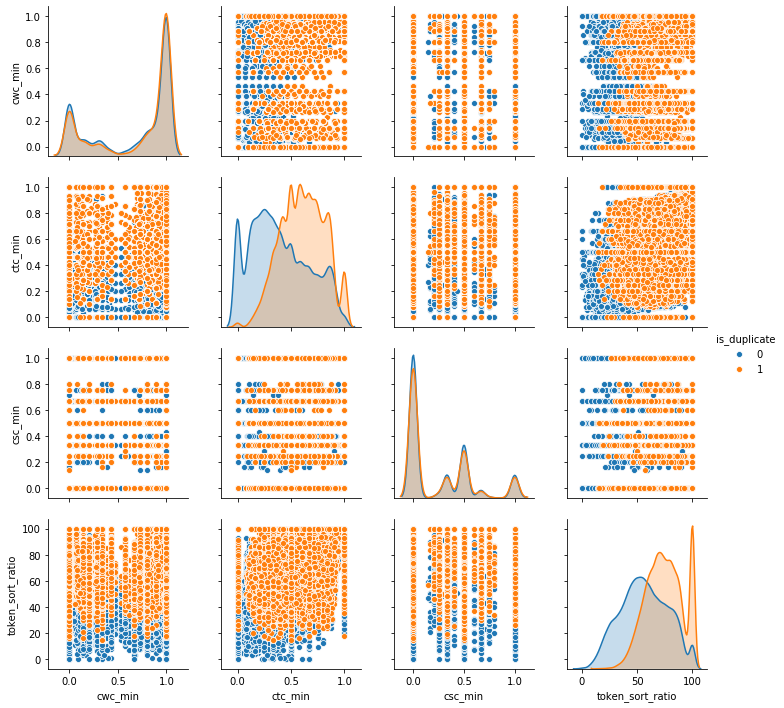

In [57]:
plt.figure(figsize=(25,20))
sns.pairplot(quora,vars=['cwc_min','ctc_min','csc_min','token_sort_ratio'],hue='is_duplicate')
plt.show()

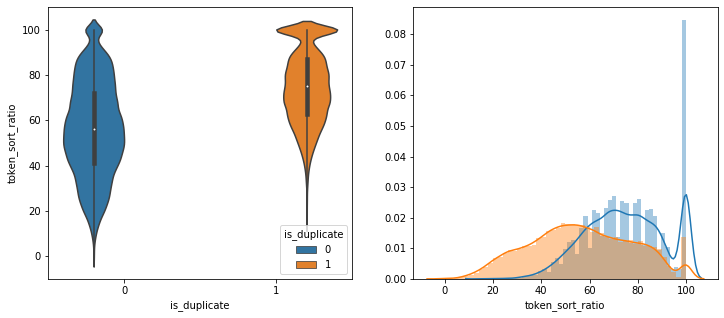

In [58]:
plt.figure(figsize=(12,5))
plt.subplot(1,2,1)
sns.violinplot(x="is_duplicate",y="token_sort_ratio",hue="is_duplicate",data=quora)
plt.subplot(1,2,2)
sns.distplot(quora[quora['is_duplicate']==1]['token_sort_ratio'])
sns.distplot(quora[quora['is_duplicate']==0]['token_sort_ratio'])
plt.show()


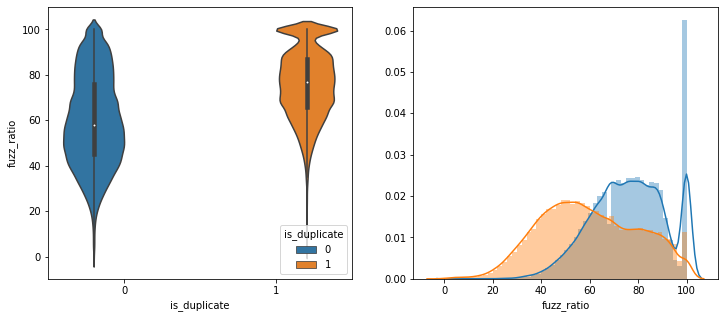

In [59]:
plt.figure(figsize=(12,5))
plt.subplot(1,2,1)
sns.violinplot(x="is_duplicate",y="fuzz_ratio",hue="is_duplicate",data=quora)
plt.subplot(1,2,2)
sns.distplot(quora[quora['is_duplicate']==1]['fuzz_ratio'])
sns.distplot(quora[quora['is_duplicate']==0]['fuzz_ratio'])
plt.show()


In [60]:
from sklearn.preprocessing import MinMaxScaler
quora_sampled=quora[:5000]
X=MinMaxScaler().fit_transform(quora_sampled[['cwc_min','cwc_max','csc_min','csc_max','ctc_min','ctc_max','first_word_eq','last_word_eq','abs_len_diff','mean_len','fuzz_ratio','fuzz_partial_ratio','token_sort_ratio','token_set_ratio','longest_substr_ratio']])
Y=quora_sampled['is_duplicate'].values

In [61]:
from sklearn.manifold import TSNE
tsne2d=TSNE(n_components=2,init='random',random_state=101,method='barnes_hut',n_iter=1000,verbose=2,angle=0.5).fit_transform(X)

[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 5000 samples in 0.016s...
[t-SNE] Computed neighbors for 5000 samples in 0.964s...
[t-SNE] Computed conditional probabilities for sample 1000 / 5000
[t-SNE] Computed conditional probabilities for sample 2000 / 5000
[t-SNE] Computed conditional probabilities for sample 3000 / 5000
[t-SNE] Computed conditional probabilities for sample 4000 / 5000
[t-SNE] Computed conditional probabilities for sample 5000 / 5000
[t-SNE] Mean sigma: 0.169398
[t-SNE] Computed conditional probabilities in 0.574s
[t-SNE] Iteration 50: error = 81.4893646, gradient norm = 0.0338954 (50 iterations in 5.463s)
[t-SNE] Iteration 100: error = 68.7006073, gradient norm = 0.0116756 (50 iterations in 4.355s)
[t-SNE] Iteration 150: error = 66.2160721, gradient norm = 0.0066254 (50 iterations in 4.078s)
[t-SNE] Iteration 200: error = 65.1310883, gradient norm = 0.0049379 (50 iterations in 3.988s)
[t-SNE] Iteration 250: error = 64.4947739, gradient norm = 0.0033584

C:\Users\aditya raj\Anaconda3\lib\site-packages\seaborn\regression.py:546: UserWarning:

The `size` paramter has been renamed to `height`; please update your code.



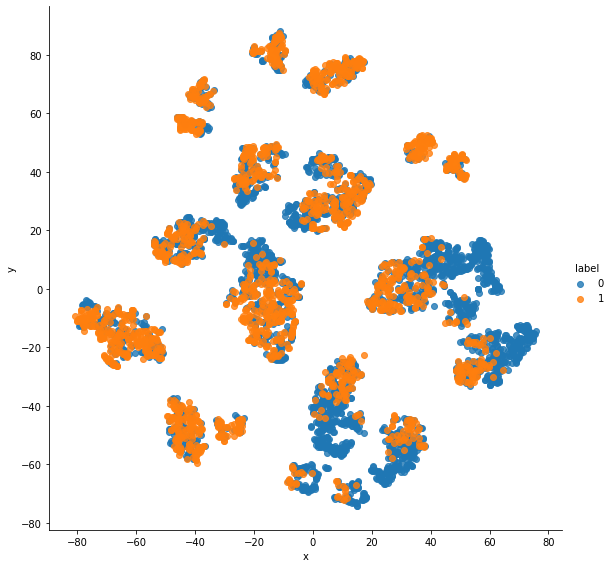

In [62]:
df=pd.DataFrame({'x':tsne2d[:,0],'y':tsne2d[:,1],'label':Y})
sns.lmplot(data=df,x='x',y='y',hue='label',fit_reg=False,size=8)
plt.show()

In [63]:
!pip install spacy

In [41]:
questions=[]
for i in np.arange(0,100000):
    for word in quora['question1'][i]:
        questions.append(word)
    for word in quora['question2'][i]:
        questions.append(word)
        
print(questions)   

['step', 'step', 'guid', 'invest', 'share', 'market', 'india', 'step', 'step', 'guid', 'invest', 'share', 'market', 'stori', 'kohinoor', 'kohinoor', 'diamond', 'would', 'happen', 'indian', 'govern', 'steal', 'kohinoor', 'kohinoor', 'diamond', 'back', 'increas', 'speed', 'internet', 'connect', 'use', 'vpn', 'internet', 'speed', 'increas', 'hack', 'dn', 'mental', 'lone', 'solv', 'find', 'remaind', 'math2324math', 'divid', 'two', 'thousand', ',', 'four', 'hundr', 'twenty-thre', 'one', 'dissolv', 'water', 'quikli', 'sugar', 'salt', 'methan', 'carbon', 'di', 'oxid', 'fish', 'would', 'surviv', 'salt', 'water', 'astrolog', 'capricorn', 'sun', 'cap', 'moon', 'cap', 'risingwhat', 'say', 'im', 'tripl', 'capricorn', 'sun', 'moon', 'ascend', 'capricorn', 'say', 'buy', 'tiago', 'keep', 'childern', 'activ', 'far', 'phone', 'video', 'game', 'good', 'geologist', 'great', 'geologist', 'use', 'シ', 'instead', 'し', 'use', 'instead', 'motorola', 'compani', 'hack', 'charter', 'motorolla', 'dcx3400', 'hack',

In [42]:
from sklearn.feature_extraction.text import TfidfVectorizer
tfidf=TfidfVectorizer(lowercase=False, )
tfidf.fit_transform(questions)

tfidfword=dict(zip(tfidf.get_feature_names(),tfidf.idf_))
print(tfidfword)

{'000': 13.84182373694881, '000webhost': 14.247288845056975, '000webhostcom': 14.247288845056975, '0019': 14.247288845056975, '0180dev': 14.247288845056975, '018π': 14.247288845056975, '01987ml': 14.247288845056975, '01j': 13.84182373694881, '02': 14.247288845056975, '02int': 14.247288845056975, '035m': 14.247288845056975, '04091982male0828amist': 13.84182373694881, '04i': 13.84182373694881, '0523598': 14.247288845056975, '05x2': 14.247288845056975, '066': 13.84182373694881, '067972477x': 14.247288845056975, '06j': 14.247288845056975, '06x08': 14.247288845056975, '075gib': 14.247288845056975, '07pq': 14.247288845056975, '081993': 14.247288845056975, '08i': 13.84182373694881, '09': 14.247288845056975, '0frac1xfracxx1math': 14.247288845056975, '0fracsinfrac1xfrac1x0math': 14.247288845056975, '0fracsinxx1math': 14.247288845056975, '0fracxtan': 14.247288845056975, '0math': 13.330998113182819, '0pwr6': 14.247288845056975, '0s': 13.84182373694881, '0w30': 14.247288845056975, '0x80004004': 14

In [43]:
import en_core_web_sm
nlp = en_core_web_sm.load()

In [44]:
question_1=[]
question_2=[]
for i in np.arange(100000):
    doc=nlp(str(quora['question1'][i]))
    doc2=nlp(str(quora['question2'][i]))
    q1=[]
    q2=[]
    for word in doc:
        q1.append((word.vector*tfidfword['word']).mean())
    question_1.append(q1)
    for word in doc2:
        q2.append((word.vector*tfidfword['word']).mean())
    question_2.append(q2)

In [45]:
w1=pd.DataFrame(question_1)
w2=pd.DataFrame(question_2)

In [46]:
w1.columns=np.arange(0,218)

In [47]:
w2.columns=np.arange(218,659)

In [48]:
quora=quora.join(w1)

In [49]:
quora=quora.join(w2)

In [50]:
quora1=quora.drop('question1',axis=1)

In [51]:
quora1=quora1.drop('question2',axis=1)

In [52]:
quora1=quora1.drop('id',axis=1)

In [53]:
quora1=quora1.drop('qid1',axis=1)
quora1=quora1.drop('qid2',axis=1)
quora1

,is_duplicate,freq_qid1,freq_qid2,q1len,q2len,q1_n_words,q2_n_words,word_Common,word_total,word_share,...,649,650,651,652,653,654,655,656,657,658
0,0,1,1,66,57,14,12,12,26,0.461538,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,0,1,1,51,88,8,13,8,21,0.380952,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,0,1,1,73,59,14,10,10,24,0.416667,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,0,1,1,50,65,11,9,9,20,0.450000,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,0,1,1,76,39,13,7,5,20,0.250000,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
99995,0,1,1,81,63,16,13,0,29,0.000000,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
99996,0,1,1,49,43,10,9,8,19,0.421053,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
99997,0,1,1,57,45,9,10,8,19,0.421053,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
99998,0,2,1,42,35,9,7,1,16,0.062500,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [54]:
Y=quora1['is_duplicate']
X=quora1.drop('is_duplicate',axis=1)

In [55]:
X.columns=np.arange(0,685)
X

,0,1,2,3,4,5,6,7,8,9,...,675,676,677,678,679,680,681,682,683,684
0,1,1,66,57,14,12,12,26,0.461538,2,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,1,1,51,88,8,13,8,21,0.380952,2,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,1,1,73,59,14,10,10,24,0.416667,2,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,1,1,50,65,11,9,9,20,0.450000,2,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,1,1,76,39,13,7,5,20,0.250000,2,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
99995,1,1,81,63,16,13,0,29,0.000000,2,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
99996,1,1,49,43,10,9,8,19,0.421053,2,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
99997,1,1,57,45,9,10,8,19,0.421053,2,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
99998,2,1,42,35,9,7,1,16,0.062500,3,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [56]:
Y

0        0
1        0
2        0
3        0
4        0
        ..
99995    0
99996    0
99997    0
99998    0
99999    1
Name: is_duplicate, Length: 100000, dtype: int64

In [26]:
from sklearn.linear_model import SGDClassifier
from sklearn.calibration import CalibratedClassifierCV
from sklearn.metrics import log_loss
from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix
#the function below is taken from applied AI mentor's google collab 
# This function plots the confusion matrices given y_i, y_i_hat.
def plot_confusion_matrix(test_y, predict_y):
    C = confusion_matrix(test_y, predict_y)
    # C = 9,9 matrix, each cell (i,j) represents number of points of class i are predicted class j
    
    A =(((C.T)/(C.sum(axis=1))).T)
    #divid each element of the confusion matrix with the sum of elements in that column
    
    # C = [[1, 2],
    #     [3, 4]]
    # C.T = [[1, 3],
    #        [2, 4]]
    # C.sum(axis = 1)  axis=0 corresonds to columns and axis=1 corresponds to rows in two diamensional array
    # C.sum(axix =1) = [[3, 7]]
    # ((C.T)/(C.sum(axis=1))) = [[1/3, 3/7]
    #                           [2/3, 4/7]]

    # ((C.T)/(C.sum(axis=1))).T = [[1/3, 2/3]
    #                           [3/7, 4/7]]
    # sum of row elements = 1
    
    B =(C/C.sum(axis=0))
    #divid each element of the confusion matrix with the sum of elements in that row
    # C = [[1, 2],
    #     [3, 4]]
    # C.sum(axis = 0)  axis=0 corresonds to columns and axis=1 corresponds to rows in two diamensional array
    # C.sum(axix =0) = [[4, 6]]
    # (C/C.sum(axis=0)) = [[1/4, 2/6],
    #                      [3/4, 4/6]] 
    plt.figure(figsize=(20,6))
    
    labels = [1,2]
    # representing A in heatmap format
    cmap=sns.light_palette("blue")
    plt.subplot(1, 3, 1)
    sns.heatmap(C, annot=True, cmap=cmap, fmt=".3f", xticklabels=labels, yticklabels=labels)
    plt.xlabel('Predicted Class')
    plt.ylabel('Original Class')
    plt.title("Confusion matrix")
    
    plt.subplot(1, 3, 2)
    sns.heatmap(B, annot=True, cmap=cmap, fmt=".3f", xticklabels=labels, yticklabels=labels)
    plt.xlabel('Predicted Class')
    plt.ylabel('Original Class')
    plt.title("Precision matrix")
    
    plt.subplot(1, 3, 3)
    # representing B in heatmap format
    sns.heatmap(A, annot=True, cmap=cmap, fmt=".3f", xticklabels=labels, yticklabels=labels)
    plt.xlabel('Predicted Class')
    plt.ylabel('Original Class')
    plt.title("Recall matrix")
    
    plt.show()

In [58]:
quora1.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 100000 entries, 0 to 99999
Columns: 686 entries, is_duplicate to 658
dtypes: float64(668), int64(18)
memory usage: 523.4 MB


In [59]:
X=X.fillna(0)
X

,0,1,2,3,4,5,6,7,8,9,...,675,676,677,678,679,680,681,682,683,684
0,1,1,66,57,14,12,12,26,0.461538,2,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,1,1,51,88,8,13,8,21,0.380952,2,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,1,1,73,59,14,10,10,24,0.416667,2,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,1,1,50,65,11,9,9,20,0.450000,2,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,1,1,76,39,13,7,5,20,0.250000,2,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
99995,1,1,81,63,16,13,0,29,0.000000,2,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
99996,1,1,49,43,10,9,8,19,0.421053,2,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
99997,1,1,57,45,9,10,8,19,0.421053,2,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
99998,2,1,42,35,9,7,1,16,0.062500,3,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [6]:
x_train,x_test,y_train,y_test=train_test_split(X,Y,test_size=0.3,random_state=101)

In [230]:
alpha=[10**-4,10**-3,10**-2,10**-1,1,10,10**2,10**3]
log_loss_error=[]
for i in alpha:
    model=SGDClassifier(alpha=i,loss='log',penalty='l2',random_state=42)
    model.fit(x_train,y_train)
    cal_mod=CalibratedClassifierCV(model,method='sigmoid')
    cal_mod.fit(x_train,y_train)
    pred_y=cal_mod.predict_proba(x_test)
    log_loss_error.append(log_loss(y_test,pred_y,labels=model.classes_))
    

C:\Users\aditya raj\Anaconda3\lib\site-packages\sklearn\model_selection\_split.py:1978: FutureWarning:

The default value of cv will change from 3 to 5 in version 0.22. Specify it explicitly to silence this warning.

C:\Users\aditya raj\Anaconda3\lib\site-packages\sklearn\model_selection\_split.py:1978: FutureWarning:

The default value of cv will change from 3 to 5 in version 0.22. Specify it explicitly to silence this warning.

C:\Users\aditya raj\Anaconda3\lib\site-packages\sklearn\model_selection\_split.py:1978: FutureWarning:

The default value of cv will change from 3 to 5 in version 0.22. Specify it explicitly to silence this warning.

C:\Users\aditya raj\Anaconda3\lib\site-packages\sklearn\model_selection\_split.py:1978: FutureWarning:

The default value of cv will change from 3 to 5 in version 0.22. Specify it explicitly to silence this warning.

C:\Users\aditya raj\Anaconda3\lib\site-packages\sklearn\model_selection\_split.py:1978: FutureWarning:

The default value of cv will

In [231]:
print(log_loss_error)

[0.5610647770032567, 0.5663971400791141, 0.538146451009573, 0.5434248312556892, 0.578404532783337, 0.592673033445944, 0.6049808040129361, 0.6275916440383764]


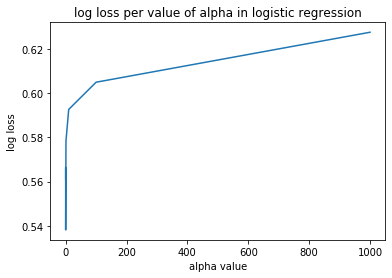

In [235]:
plt.plot(alpha,log_loss_error)
plt.xlabel('alpha value')
plt.ylabel('log loss')
plt.title('log loss per value of alpha in logistic regression')
plt.show()

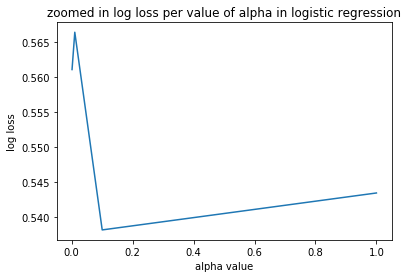

In [237]:
#zooming the graph
xs=[10**-3,10**-2,10**-1,1]
plt.plot(xs,log_loss_error[0:4])
plt.xlabel('alpha value')
plt.ylabel('log loss')
plt.title('zoomed in log loss per value of alpha in logistic regression')
plt.show()

In [239]:
print("The minimum log loss value is",min(log_loss_error),"and it occurs at the alpha value of",alpha[log_loss_error.index(min(log_loss_error))])

The minimum log loss value is 0.538146451009573 and it occurs at the alpha value of 0.01


In [247]:
model=SGDClassifier(alpha=0.01,loss='log',penalty='l2',random_state=42)
model.fit(x_train,y_train)
cal_mod=CalibratedClassifierCV(model,method='sigmoid')
cal_mod.fit(x_train,y_train)
pred_y=cal_mod.predict(x_test)

C:\Users\aditya raj\Anaconda3\lib\site-packages\sklearn\model_selection\_split.py:1978: FutureWarning:

The default value of cv will change from 3 to 5 in version 0.22. Specify it explicitly to silence this warning.



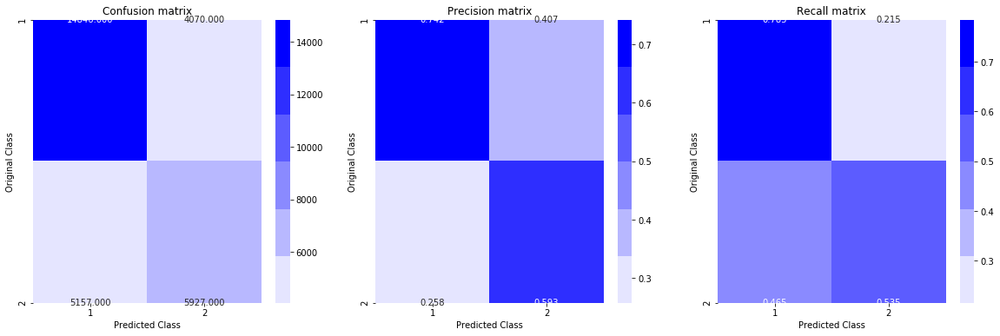

In [256]:
plot_confusion_matrix(y_test, pred_y)

In [257]:
svm_log_loss=[]
for i in alpha:
    model=SGDClassifier(alpha=i,loss='hinge',penalty='l1',random_state=42)
    model.fit(x_train,y_train)
    cal_mod=CalibratedClassifierCV(model,method='sigmoid')
    cal_mod.fit(x_train,y_train)
    pred_y=cal_mod.predict_proba(x_test)
    svm_log_loss.append(log_loss(y_test,pred_y,labels=model.classes_))

C:\Users\aditya raj\Anaconda3\lib\site-packages\sklearn\model_selection\_split.py:1978: FutureWarning:

The default value of cv will change from 3 to 5 in version 0.22. Specify it explicitly to silence this warning.

C:\Users\aditya raj\Anaconda3\lib\site-packages\sklearn\calibration.py:455: RuntimeWarning:

invalid value encountered in multiply

C:\Users\aditya raj\Anaconda3\lib\site-packages\sklearn\calibration.py:455: RuntimeWarning:

invalid value encountered in multiply

C:\Users\aditya raj\Anaconda3\lib\site-packages\sklearn\model_selection\_split.py:1978: FutureWarning:

The default value of cv will change from 3 to 5 in version 0.22. Specify it explicitly to silence this warning.

C:\Users\aditya raj\Anaconda3\lib\site-packages\sklearn\model_selection\_split.py:1978: FutureWarning:

The default value of cv will change from 3 to 5 in version 0.22. Specify it explicitly to silence this warning.

C:\Users\aditya raj\Anaconda3\lib\site-packages\sklearn\model_selection\_split.py:197

In [258]:
print(svm_log_loss)

[0.5375769597388178, 0.5373405181048782, 0.5361499917239584, 0.5614759276388036, 0.6183526933011962, 0.6412206271074739, 0.6587143571740899, 0.6587143571740897]


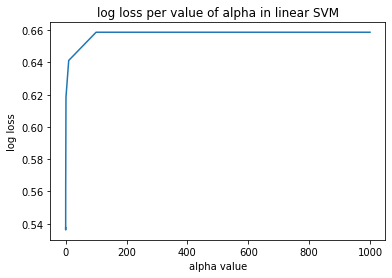

In [259]:
plt.plot(alpha,svm_log_loss)
plt.xlabel('alpha value')
plt.ylabel('log loss')
plt.title('log loss per value of alpha in linear SVM')
plt.show()

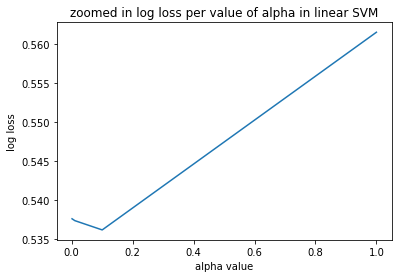

In [260]:
xs=[10**-3,10**-2,10**-1,1]
plt.plot(xs,svm_log_loss[0:4])
plt.xlabel('alpha value')
plt.ylabel('log loss')
plt.title('zoomed in log loss per value of alpha in linear SVM')
plt.show()

In [261]:
print("The minimum log loss value is",min(svm_log_loss),"and it occurs at the alpha value of",alpha[svm_log_loss.index(min(svm_log_loss))])

The minimum log loss value is 0.5361499917239584 and it occurs at the alpha value of 0.01


In [32]:
model=SGDClassifier(alpha=0.01,loss='hinge',penalty='l1',random_state=42)
model.fit(x_train,y_train)
cal_mod=CalibratedClassifierCV(model,method='sigmoid')
cal_mod.fit(x_train,y_train)
pred_y=cal_mod.predict(x_test)

C:\Users\aditya raj\Anaconda3\lib\site-packages\sklearn\linear_model\stochastic_gradient.py:561: ConvergenceWarning:

Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.

C:\Users\aditya raj\Anaconda3\lib\site-packages\sklearn\model_selection\_split.py:1978: FutureWarning:

The default value of cv will change from 3 to 5 in version 0.22. Specify it explicitly to silence this warning.

C:\Users\aditya raj\Anaconda3\lib\site-packages\sklearn\calibration.py:455: RuntimeWarning:

invalid value encountered in multiply

C:\Users\aditya raj\Anaconda3\lib\site-packages\sklearn\linear_model\stochastic_gradient.py:561: ConvergenceWarning:

Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.

C:\Users\aditya raj\Anaconda3\lib\site-packages\sklearn\calibration.py:455: RuntimeWarning:

invalid value encountered in multiply

C:\Users\aditya raj\Anaconda3\lib\site-packages\sklearn\calibration.py:

C:\Users\aditya raj\Anaconda3\lib\site-packages\ipykernel_launcher.py:28: RuntimeWarning:

invalid value encountered in true_divide



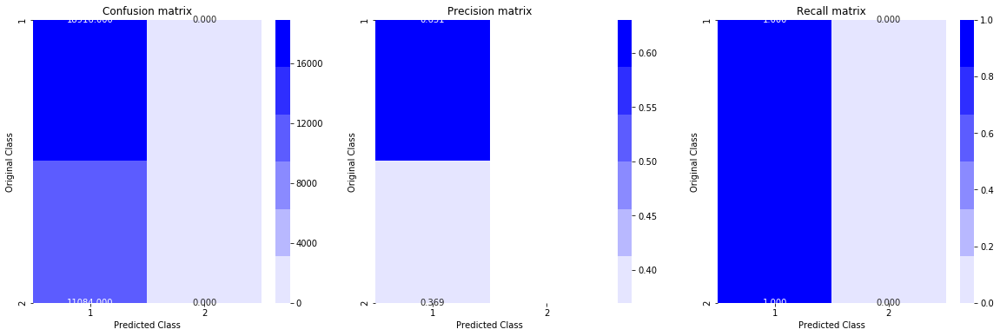

In [33]:
plot_confusion_matrix(y_test, pred_y)

In [81]:
!pip install xgboost
from sklearn.model_selection import GridSearchCV
import xgboost as xgb

In [8]:
from sklearn.model_selection import GridSearchCV
import xgboost as xgb
from xgboost import XGBClassifier
estimator = XGBClassifier(
    objective= 'binary:logistic',
    nthread=4,
    seed=42
)

In [4]:
X=pd.read_csv('X.csv')
X

,Unnamed: 0,0,1,2,3,4,5,6,7,8,...,675,676,677,678,679,680,681,682,683,684
0,0,1,1,66,57,14,12,12,26,0.461538,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,1,1,1,51,88,8,13,8,21,0.380952,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,2,1,1,73,59,14,10,10,24,0.416667,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,3,1,1,50,65,11,9,9,20,0.450000,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,4,1,1,76,39,13,7,5,20,0.250000,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
99995,99995,1,1,81,63,16,13,0,29,0.000000,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
99996,99996,1,1,49,43,10,9,8,19,0.421053,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
99997,99997,1,1,57,45,9,10,8,19,0.421053,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
99998,99998,2,1,42,35,9,7,1,16,0.062500,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [5]:
Y=quora['is_duplicate']
Y=Y[:100000]
Y

0        0
1        0
2        0
3        0
4        0
        ..
99995    0
99996    0
99997    0
99998    0
99999    1
Name: is_duplicate, Length: 100000, dtype: int64

In [ ]:
from sklearn.model_selection import RandomizedSearchCV
parameters = {
    'n_estimators': range(100, 500, 100),
    'learning_rate': [0.1, 0.01,0.001,0.05],
    'subsample': [0.6, 0.8, 1.0],
    'colsample_bytree': [0.6, 0.8, 1.0],
    'max_depth': [3, 4, 5]
 
}
random_search = RandomizedSearchCV(estimator, param_distributions=parameters, n_iter=15, scoring='f1', n_jobs=-1, cv=5, verbose=3, random_state=1001 )
random_search.fit(x_train,y_train)

Fitting 5 folds for each of 15 candidates, totalling 75 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  16 tasks      | elapsed: 58.4min
[Parallel(n_jobs=-1)]: Done  75 out of  75 | elapsed: 533.2min finished


RandomizedSearchCV(cv=5, error_score='raise-deprecating',
                   estimator=XGBClassifier(base_score=None, booster=None,
                                           colsample_bylevel=None,
                                           colsample_bynode=None,
                                           colsample_bytree=None, gamma=None,
                                           gpu_id=None, importance_type='gain',
                                           interaction_constraints=None,
                                           learning_rate=None,
                                           max_delta_step=None, max_depth=None,
                                           min_child_weight=None, missing=nan,
                                           monotone_co...
                                           subsample=None, tree_method=None,
                                           validate_parameters=None,
                                           verbosity=None),
                  

In [3]:
X=pd.read_csv('X.csv')
X

,Unnamed: 0,0,1,2,3,4,5,6,7,8,...,675,676,677,678,679,680,681,682,683,684
0,0,1,1,66,57,14,12,12,26,0.461538,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,1,1,1,51,88,8,13,8,21,0.380952,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,2,1,1,73,59,14,10,10,24,0.416667,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,3,1,1,50,65,11,9,9,20,0.450000,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,4,1,1,76,39,13,7,5,20,0.250000,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
99995,99995,1,1,81,63,16,13,0,29,0.000000,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
99996,99996,1,1,49,43,10,9,8,19,0.421053,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
99997,99997,1,1,57,45,9,10,8,19,0.421053,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
99998,99998,2,1,42,35,9,7,1,16,0.062500,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [18]:
Y=quora['is_duplicate']
Y=Y[:100000]
Y

0        0
1        0
2        0
3        0
4        0
        ..
99995    0
99996    0
99997    0
99998    0
99999    1
Name: is_duplicate, Length: 100000, dtype: int64

In [19]:
best_parameters=random_search.best_params_
best_parameters

{'subsample': 1.0,
 'n_estimators': 300,
 'max_depth': 5,
 'learning_rate': 0.1,
 'colsample_bytree': 1.0}

In [21]:
best_model=random_search.best_estimator_
best_model

XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=1,
              colsample_bynode=1, colsample_bytree=1.0, gamma=0, gpu_id=-1,
              importance_type='gain', interaction_constraints='',
              learning_rate=0.1, max_delta_step=0, max_depth=5,
              min_child_weight=1, missing=nan, monotone_constraints='()',
              n_estimators=300, n_jobs=4, nthread=4, num_parallel_tree=1,
              objective='binary:logistic', random_state=42, reg_alpha=0,
              reg_lambda=1, scale_pos_weight=1, seed=42, subsample=1.0,
              tree_method='exact', validate_parameters=1, verbosity=None)

In [22]:
best_model.fit(x_train,y_train)
y_pred=best_model.predict_proba(x_test)
y_pred

array([[6.5216106e-01, 3.4783894e-01],
       [4.0549070e-01, 5.9450930e-01],
       [3.5522288e-01, 6.4477712e-01],
       ...,
       [6.3513923e-01, 3.6486080e-01],
       [6.7116988e-01, 3.2883012e-01],
       [9.9905366e-01, 9.4634638e-04]], dtype=float32)

In [30]:
print(log_loss(y_test,y_pred,labels=model.classes_))

0.43120521024132563


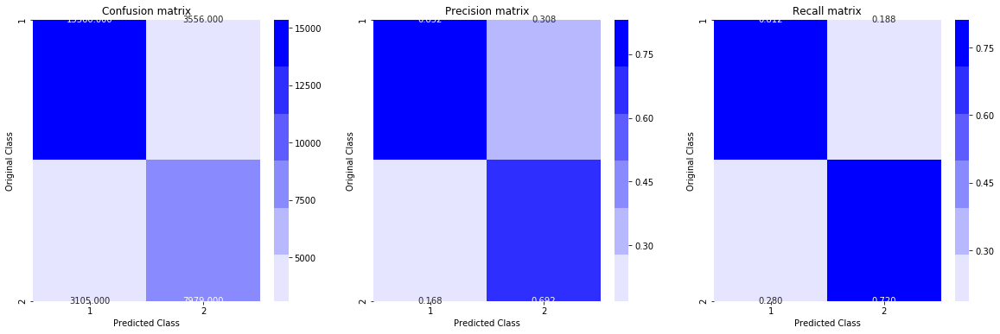

In [31]:
plot_confusion_matrix(y_test,best_model.predict(x_test))